In [1]:
%load_ext autoreload
%autoreload 2
exec(open('init_notebook.py').read())
from matplotlib import pyplot as plt
from highD.HighD import HighD
from highD.Filter import Filter
from highD.Plot import Plot
from highD.Visualizer import GIF
from highD.helper import *

current working dirC:\Users\abjaw\Documents\GitHub\CogMod-driver-behavior-model\highd_tools


In [2]:
ids = ["01", "02"]
highD = HighD(ids, DATA_DIRECTORY)

dataset_id = 0
_, tMeta, tracks = highD.get_dataframe_tuple(dataset_id)
df = highD.get_combined_dataframe(dataset_id)
image = highD.get_image(dataset_id)

Loaded data and image for dataset 01.
Loaded data and image for dataset 02.


In [ ]:

combined_dfs = combine_data(dfs)

dataset_id = 0

combined_df = combined_dfs[dataset_id]
image = images[dataset_id]
combined_df.head()

combined_df.shape (348750, 29)
combined_df.shape (378115, 29)
combined_df.columns Index(['dataset_id', 'locationId', 'frame', 'id', 'class', 'drivingDirection',
       'laneId', 'x', 'y', 'width', 'height', 'xVelocity', 'yVelocity',
       'xAcceleration', 'yAcceleration', 'frontSightDistance',
       'backSightDistance', 'dhw', 'thw', 'ttc', 'precedingXVelocity',
       'precedingId', 'followingId', 'leftPrecedingId', 'leftAlongsideId',
       'leftFollowingId', 'rightPrecedingId', 'rightAlongsideId',
       'rightFollowingId'],
      dtype='object')


,dataset_id,locationId,frame,id,class,drivingDirection,laneId,x,y,width,...,ttc,precedingXVelocity,precedingId,followingId,leftPrecedingId,leftAlongsideId,leftFollowingId,rightPrecedingId,rightAlongsideId,rightFollowingId
0,1,2,1,1,Car,2,5,362.26,21.68,4.85,...,0.0,0.0,0,3,0,0,0,0,0,6
1,1,2,2,1,Car,2,5,363.73,21.68,4.85,...,0.0,0.0,0,14,0,0,0,0,0,6
2,1,2,3,1,Car,2,5,365.27,21.68,4.85,...,0.0,0.0,0,14,0,0,0,0,0,6
3,1,2,4,1,Car,2,5,366.83,21.68,4.85,...,0.0,0.0,0,14,0,0,0,0,0,6
4,1,2,5,1,Car,2,5,368.42,21.68,4.85,...,0.0,0.0,0,14,0,0,0,0,0,6


In [ ]:
import pandas as pd
import numpy as np

import pandas as pd

def find_left_right_lanes(df: pd.DataFrame) -> tuple:
    unique_lane_ids = df['laneId'].unique()
    left_lanes = []
    right_lanes = []

    for lane_id in unique_lane_ids:
        lane_df = df[df['laneId'] == lane_id]
        if lane_df['xVelocity'].iloc[0] < 0:  # Negative X velocity means left
            left_lanes.append(lane_id)
        else:
            right_lanes.append(lane_id)

    return left_lanes, right_lanes

def filter_by_scenario_start_distance(df: pd.DataFrame, ego_type: str, preceding_type: str, distance: float = 20) -> pd.DataFrame:
    ego_df = df[df['class'] == ego_type].groupby('id').filter(lambda x: x['laneId'].nunique() == 1)
    preceding_df = df[df['class'] == preceding_type].groupby('id').filter(lambda x: x['laneId'].nunique() == 1)

    left_lanes, right_lanes = find_left_right_lanes(df)

    # filter out the ego vehicles that has preceding vehicle == 0 for the full trajectory
    ego_to_exclude = []
    for ego_id in ego_df['id'].unique():
        ego_vehicle_df = ego_df[ego_df['id'] == ego_id]
        preceding_vehicle_ids = ego_vehicle_df['precedingId'].unique()
        if len(set(preceding_vehicle_ids)) == 1 and 0 in preceding_vehicle_ids:
            ego_to_exclude.append(ego_id)
        if preceding_vehicle_ids not in preceding_df['id'].unique():
            ego_to_exclude.append(ego_id)
    ego_df = ego_df[~ego_df['id'].isin(ego_to_exclude)]
    print(len(ego_df['id'].unique()))



    # ego_df_preceding_ids = np.unique(ego_df['precedingId'].values)
    # print(len(ego_df_preceding_ids))
    

    # Extract the valid ego vehicle ids
    # valid_ego_ids = valid_pairs_df['id_ego'].unique()

    # # Filter the original DataFrame based on the valid_ego_ids
    # filtered_df = df[df['id'].isin(valid_ego_ids)]
    return ego_df

car_follow_scenario = filter_by_scenario_start_distance(combined_df, 'Car', 'Car', 350)

# print(car_follow_scenario.shape)
# print(car_follow_scenario['id'].nunique())
# car_follow_scenario.head()



20


Agent ID: 1025
start: 22064, end: 22368 


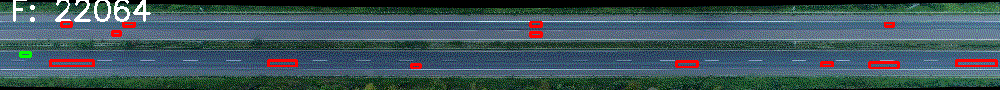

In [ ]:
import random
from PIL import Image

agent_id = random.choice(car_follow_scenario['id'].unique())
print(f"Agent ID: {agent_id}")
def create_gif_for_agent(image, tracks, agent_id, 
                            fps=25, output_dir=None):

    df_ego = tracks[tracks['id'] == agent_id]

    start = int(df_ego['frame'].min())
    end = int(df_ego['frame'].max())    

    print(f"start: {start}, end: {end} ")
    gif_name = f'agent_{agent_id}_fr_{start}_to_{end}.gif'
    images = []

    for i in range(start, end + 1):
        img = Visualizer.draw_frame(image=image, tracks=tracks, frame_id=i,
                                    ego_id=agent_id,
                                    ego_color=(0, 255, 0))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        pil_img = Image.fromarray(img)
        images.append(pil_img)

    if output_dir is None:
        output_dir = os.getcwd()

    gif_path = os.path.join(output_dir, gif_name)
    images[0].save(gif_path, save_all=True, append_images=images[1:],
                    optimize=False, duration=int(1000/fps), loop=0)
    return gif_path

gif_path = create_gif_for_agent(image, combined_df, agent_id, 25, OUTPUT_DIRECTORY)
display_animated_gif(gif_path)